# making film


In [25]:
# Physical parameters:
nu  = 1e-6    # in m^2 .s -1   ~ 1 cSt (centi-Stokes)
g   = 9.81 
      


In [26]:
# Import all the library: 
 
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import scipy.io
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

from netCDF4 import Dataset
import cmocean

cmapSpeed =  cmocean.cm.speed
cmapBalance =  cmocean.cm.balance
cmapCurl =  cmocean.cm.curl
cmapDiff =  cmocean.cm.diff

cmap1 = plt.cm.Spectral_r
cmap2 = plt.cm.bwr
cmap3 = plt.cm.seismic

In [27]:
# Importation of the function that manage the extraction of all the data from the `load_data.py' 
import load_data as data      # the py script `load_data.py' must be in the same folder than this notebook

# Importation of the differents function of this script 
import functions_setting as function

from animation_utils import create_animation
from animation_utils import create_animation_dual


In [28]:
Coord_y = data.get_variable(str('EXP12'), 'STEREO', 'coord_y')
Coord_x = data.get_variable(str('EXP12'), 'STEREO', 'coord_x')
dy      = np.array(Coord_y[1]-Coord_y[0])
dx      = np.array(Coord_x[1]-Coord_x[0])

time    = data.get_variable('EXP12', 'STEREO', 'Time')
U      = data.get_variable('EXP12', 'STEREO', 'U') 
W      = data.get_variable('EXP12', 'STEREO', 'W')
V      = data.get_variable('EXP12', 'STEREO', 'V')
uprime = data.get_variable('EXP12', 'STEREO', 'Uprime') 
wprime = data.get_variable('EXP12', 'STEREO', 'Wprime')
vprime = data.get_variable('EXP12', 'STEREO', 'Vprime')
ubar   = data.get_variable('EXP12', 'STEREO', 'Ubar')
vbar   = data.get_variable('EXP12', 'STEREO', 'Vbar')
wbar   = data.get_variable('EXP12', 'STEREO', 'Wbar')
uu     = data.get_variable('EXP12', 'STEREO', 'uu') 
uw     = data.get_variable('EXP12', 'STEREO', 'uw')
ww     = data.get_variable('EXP12', 'STEREO', 'ww')
vw     = data.get_variable('EXP12', 'STEREO', 'vw')
vv     = data.get_variable('EXP12', 'STEREO', 'vv')

In [29]:
# The Initial N (background stratification ) has been measured by eyes. 
f_ini  =  0
f_fin = 0.104
N  = 0.24
N2 = N**2




# Dynamical Analysis

## Velocity

In [30]:
# For the moment I forgot to get the U (from the PIV in X-Y) from mi matlab scrip. 
# so I have to reconstruct it 

ubar3D  = np.ones_like(uprime) 
for x in range (len(Coord_x)):
   ubar3D[x,:,:] =  ubar[:,:]
U = ubar3D +uprime

U = xr.DataArray(
    U,
    dims=['coord_x', 'coord_y', 'time'],
    coords={'coord_x': Coord_x, 'coord_y': Coord_y},
    name='Ubrut')

vbar3D  = np.ones_like(uprime) 
for x in range (len(Coord_x)):
   vbar3D[x,:,:] =  vbar[:,:]
V = vbar3D +vprime

V = xr.DataArray(
    V,
    dims=['coord_x', 'coord_y', 'time'],
    coords={'coord_x': Coord_x, 'coord_y': Coord_y},
    name='Vbrut')

wbar3D  = np.ones_like(uprime) 
for x in range (len(Coord_x)):
   wbar3D[x,:,:] =  wbar[:,:]
W = wbar3D +wprime

W = xr.DataArray(
    W,
    dims=['coord_x', 'coord_y', 'time'],
    coords={'coord_x': Coord_x, 'coord_y': Coord_y},
    name='Wbrut')

/var/folders/gl/qr_d872d4sj6k_rm1k6tskj80000gq/T/ipykernel_27540/2731035003.py:23: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  plt.colorbar(ctf, shrink=0.8, aspect=20, label='{} [{}]'.format(var_name, var_unit), extend='both')
/var/folders/gl/qr_d872d4sj6k_rm1k6tskj80000gq/T/ipykernel_27540/2731035003.py:23: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  plt.colorbar(ctf, shrink=0.8, aspect=20, label='{} [{}]'.format(var_name, var_unit), extend='both')
Animation size has reached 21059825 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and furthe

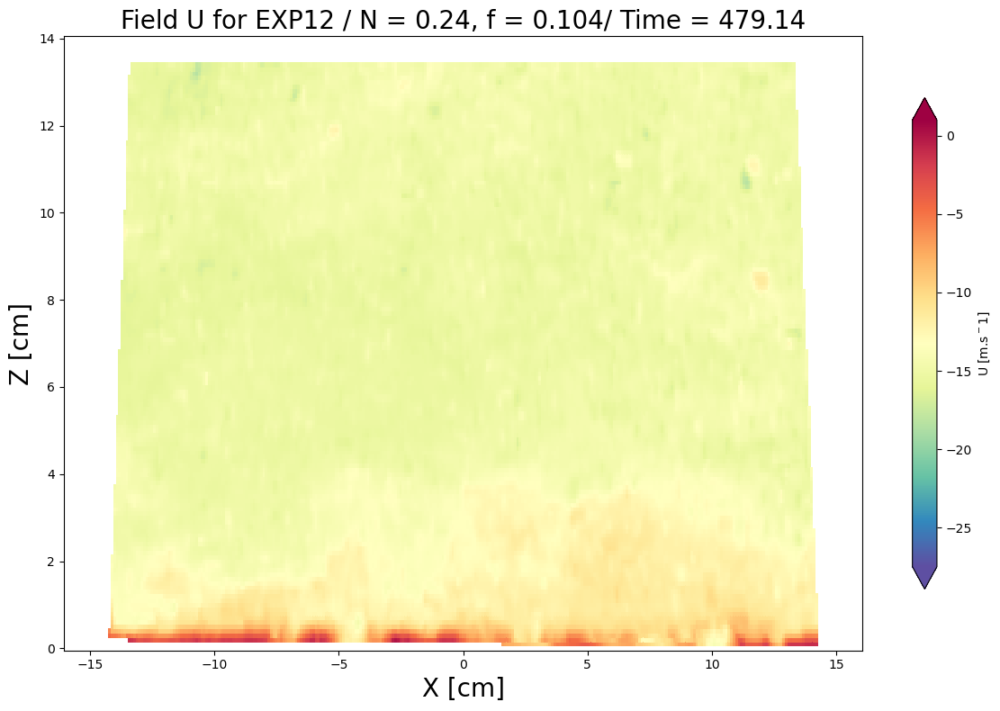

In [38]:
def film_2D(x, y, time, variable,lim_m,lim_p, var_name, var_unit, exp_name, f, N, cmapi, output_file='animation.gif'):
    '''This function computes the displacement thickness.
    Variables: 
    - exp_name : Index of the experiment exemple ('EXP12').
    - var_name : Name of the variable
    - var_unit: 'm.s^{-1}$' if velocity '''

    t_0 = np.argmin(np.abs(time.data))
    
    X,Y = np.meshgrid(y,x)
    
    # Créer la figure
    fig = plt.figure(figsize=(12, 8), tight_layout=True)
    # Création de l'animation
    def animate(i):
        plt.clf()
        #ctf = plt.contourf(Y, X, variable[:,:,i], levels=100, cmap=cmapi)
        ctf = plt.pcolor(Y, X, variable[:,:,i+t_0],  cmap=cmapi)
        plt.xlabel('X [cm]', fontsize=20)
        plt.ylabel('Z [cm]', fontsize=20)
        plt.title(str("Field {} for {} ".format(var_name, exp_name) + f'/ N = {N}, f = {f}/ Time = {time[i+t_0]:.2f}'), fontsize=20)
        ctf.set_clim(lim_m, lim_p)
        plt.colorbar(ctf, shrink=0.8, aspect=20, label='{} [{}]'.format(var_name, var_unit), extend='both')
        
    # Paramètres de l'animation
    ani = animation.FuncAnimation(fig, animate, frames=(len(time)-t_0)//2, interval=300, blit=False)  # frames = nombre d'images, interval = temps entre chaque image (en millisecondes)
    
    # Sauvegarde de l'animation au format .avi
    ani.save(output_file, writer='ffmpeg', fps=30, dpi=200)
    
    return ani

ani = film_2D(Coord_x,Coord_y, time ,U,1,-25, 'U', 'm.s$^-{1}$', 'EXP12', f_fin,N,cmap1, output_file='U_EXP12.mp4')
HTML(ani.to_jshtml())

## Vorticity

In [22]:
## Creation of the dynamical quantity field, (vorticity, Okumo-wiess etc)

vorticity_z  = np.gradient(W,axis=0)/dx-np.gradient(U,axis=1)/dy



In [23]:
ani = film_2D(Coord_x,Coord_y, time ,vorticity_z,np.nanmax(vorticity_z),np.nanmin(vorticity_z) ,'$\zeta$', 's$^-{1}$', 'EXP12', f_fin,N,cmap3, output_file='Vorticity_EXP12.mp4')
HTML(ani.to_jshtml())

/var/folders/gl/qr_d872d4sj6k_rm1k6tskj80000gq/T/ipykernel_27540/3236457827.py:22: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  plt.colorbar(ctf, shrink=0.8, aspect=20, label='{} [{}]'.format(var_name, var_unit), extend='both')
/var/folders/gl/qr_d872d4sj6k_rm1k6tskj80000gq/T/ipykernel_27540/3236457827.py:23: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  ctf.set_clim(lim_m, lim_p)


CalledProcessError: Command '['ffmpeg', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '2400x1600', '-pix_fmt', 'rgba', '-framerate', '30', '-loglevel', 'error', '-i', 'pipe:', '-vcodec', 'h264', '-pix_fmt', 'yuv420p', '-y', 'Vorticity_EXP12.mp4']' returned non-zero exit status 255.

Error in callback <function _draw_all_if_interactive at 0x109870700> (for post_execute):


ValueError: minvalue must be less than or equal to maxvalue

ValueError: minvalue must be less than or equal to maxvalue

<Figure size 1200x800 with 2 Axes>

In [ ]:
vorticity_mean = np.zeros_like(ubar)
for it in range(time.size):
    vorticity_mean[:,it] = np.nanmean(vorticity_z[:,:,it], axis  =0)


In [ ]:
It = [100, 200, 300, 400]
idt = np.zeros_like(It)
for i in range(len(It)):
    idt[i]= np.argmin(np.abs(time.data-It[i])) 
idt

In [ ]:
It = [100, 200, 300, 400]
idt = np.zeros_like(It)
for i in range(len(It)):
    idt[i]= np.argmin(np.abs(time.data-It[i])) 

fig, (ax1) = plt.subplots(1,1,figsize=(10, 8))
for i in (idt):
    ax1.plot(vorticity_mean[:,i], Coord_y, '.-', label =f'Time = {time[i]:.2f}')

ax1.grid()
plt.title('Vorticity (y-axis)/ EXP14', fontsize=16)
ax1.set_ylabel('z [m]', fontsize=16)
ax1.set_xlabel(r'Vorticity $\zeta$ [s$^{-1}$]', fontsize=16)
ax1.tick_params(axis='both', labelsize=14)
#ax1.set_ylim([-40, 0])
#ax1.set_xscale('log')
#ax1.set_yscale('log')
# Ajout de la ligne horizontale
#ax1.axhline(y=h_rot[-1], color='k', linestyle='--')
#ax1.text(.4e-5 , h_rot[-1], 'h', color='k', fontsize=20, va='bottom', ha='right')


plt.legend(fontsize=16)

## Okubo-Weiss

- _Vorticity_ = $\partial_x W - \partial_y U$
- _Divergence_ = $\partial_x U+\partial_y W$
- _Shear_ = $\partial_x W+\partial_y U$
- _Stretching_ = $\partial_x U-\partial_y W$

OW = shear$^2$ + stretching$^2$ -vorticity$^2$

In [16]:

dx_U = np.gradient(U,axis=0)/dx
dx_W = np.gradient(W,axis=0)/dx
dy_U = np.gradient(U,axis=1)/dy
dy_W = np.gradient(W,axis=1)/dy

vor = dx_W-dy_U
div = dx_U+dy_W
shear = dx_W+dy_U
stretching = dx_U-dy_W

OW = shear**2 + stretching**2 -vor**2

In [17]:
np.nanmax(OW),np.nanmin(OW)

(5327.1255, -3049.5696)

## Displacement thickness 


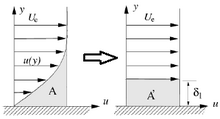

Source :https://fr.wikipedia.org/wiki/Couche_limite#/media/Fichier:Param%C3%A8tres_caract%C3%A9ristiques_de_la_couche_limites.png



If we consider A and A' to be surfaces such that : 
$A = \int_{0}^{\infty} (U_{\infty} - u)  dy = A' = \delta_{1} U_{\infty} $.

Assuming $A=A'$, the _displacement thickness_ can be written as 
$$\delta_{1} = \frac{\int_{0}^{\infty} (U_{\infty} - u)}{U_{\infty}} dy$$ 



**Reference** : Course _"Turbulence, diffusion and transport: Master Environmental Fluid Mechanics"_ **Joel Sommeria** p p90


In [8]:
def delta_exp(num_exp,cam ):
    '''This function is aim to compute the displacement thickness: 
    Variable: 
    name_exp must be a string in the format 'EXPXX'  
    cam must by either jai or stereo'''

    time =  time
    u    = -ubar_stereo[num_exp]
    dy   =  dy_stereo
    y    =  Coord_y_stereo
    ny   =  Coord_y_stereo.size


    
    # Declaration of the outpu variables
    d1     = np.zeros(time.size)
    d95_1  = np.zeros(time.size) ; d95_2  = np.zeros(time.size)
    Uout   = np.zeros(time.size)
    
    
    #main programm
    for it in range (time.size):
        Umax = np.nanmax(u[:,it])
        idMax = (np.int64(np.where(u[:,it] == Umax)))[0][0]    # I look for the  maximum of velocity (in case of a buldge in presence of rotation)
        if cam == 'jai' : 
            Uinfty = np.nanmean(u[-40:,it],axis = 0)      # mean over the last 4cm por the JAI 
            Uout[it] = Uinfty
        elif cam=='stereo'  :
            Uinfty = np.nanmean(u[-10:,it],axis = 0)     # mean over the last 1cm por the Stereo
            Uout[it] = Uinfty    
        else : 
            print("'The variable (cam) must by either 'jai' or 'stereo''")
        #return   "The variable (cam) must by either 'jai' or 'stereo'"


        # With this condition we look if the maximum of the velocity is situated in the lower part of the column, 
        # If so we must 
        
        if idMax < 2 * ny // 3: 
            valid_indices_1 = np.arange(idMax + 1, len(u[:, it]))            # We only loof above the buldge 
            valid_values_1 = np.abs(u[valid_indices_1, it] - 0.95 * Uinfty)

            if np.all(np.isnan(valid_values_1)):
                id95_1 = -1  # Indicate no valid index found
            else:
                valid_values_1 = np.where(np.isnan(valid_values_1), np.inf, valid_values_1)
                id95_1 = valid_indices_1[np.nanargmin(valid_values_1)]

            valid_indices_2 = np.arange(0, idMax)                           # Here we look bellow 
            valid_values_2 = np.abs(u[valid_indices_2, it] - 0.95 * Uinfty)

            if np.all(np.isnan(valid_values_2)):
                #print(f"All values are NaN in the range < idMax for it = {it}")
                id95_2 = -1  # Indicate no valid index found
            else:
                valid_values_2 = np.where(np.isnan(valid_values_2), np.inf, valid_values_2)
                id95_2 = valid_indices_2[np.nanargmin(valid_values_2)]

            if id95_1 != -1:
                d95_1[it] = y[id95_1]
            else:
                d95_1[it] = np.nan  # Or any value to indicate NaN condition

            if id95_2 != -1:
                d95_2[it] = y[id95_2]
            else:
                d95_2[it] = np.nan  # Or any value to indicate NaN condition
        
        else : 
            
            id95_1 = np.nanargmin(np.abs(u[:,it]- 0.95*Uinfty))
            id95_2 = np.nanargmin(np.abs(u[:,it]- 0.95*Uinfty))
            d95_1[it] = y[id95_1]
            d95_2[it] = y[id95_2]
            
        
        d1[it]  = np.sum((1 - u[:,it]/Uinfty)*dy)
    return d1, d95_1,d95_2, Uout

#cam = 'stereo'
#exp_num='EXP12'

#d1, d95_1,d95_2,Uinfty = delta_exp(exp_num,cam )

In [9]:
cam = 'jai'   
for exp in nexp_jai :
    exp_num=str('EXP'+exp)
    d1_jai[str('EXP'+exp)]      = delta_exp(exp_num,cam)[0]
    d95_1_jai[str('EXP'+exp)]   = delta_exp(exp_num,cam)[1]
    d95_2_jai[str('EXP'+exp)]   = delta_exp(exp_num,cam)[2]
    Uinfty_jai[str('EXP'+exp)]  = delta_exp(exp_num,cam)[3]
    
cam = 'stereo'   
for exp in nexp_stereo :
    exp_num=str('EXP'+exp)
    d1_stereo[str('EXP'+exp)]      = delta_exp(exp_num,cam)[0]
    d95_1_stereo[str('EXP'+exp)]   = delta_exp(exp_num,cam)[1]
    d95_2_stereo[str('EXP'+exp)]   = delta_exp(exp_num,cam)[2]
    Uinfty_stereo[str('EXP'+exp)]  = delta_exp(exp_num,cam)[3]

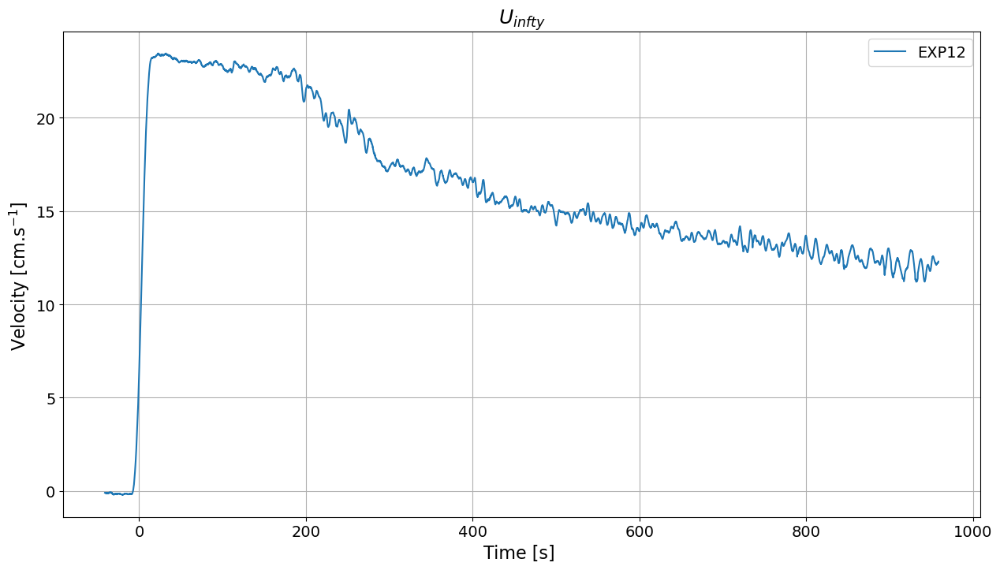

In [72]:
# Decaying law
alpha1 = 0.126
lim_rot1 = (1.17*2 / f['EXP16'])*alpha1

plt.figure(figsize=(15,8))
plt.title(r'$U_{\infty}$', fontsize=18)
plt.plot(time_stereo['EXP12'],Uinfty_stereo['EXP12'],label= 'EXP12')

plt.grid()
#plt.yscale('log')
plt.xlabel('Time [s] ', fontsize=16)
plt.ylabel(r'Velocity [cm.s$^{-1}$] ', fontsize=16)
#plt.ylim(-1,4)
#plt.xlim(0,time_stereo['EXP12'][-1])
plt.tick_params(axis='both', labelsize=14)
plt.legend(fontsize=14)
plt.show()



This cutter shows the evolution of the velocity away from the wall, the balance of the angular momentum of the fluid column. The rate of change of angular momentum is equal to the torque applied to the fluid. We then find an exponential rate of decrease in velocity (see **Sous et al, 2013**) for the thorytical developpement

The interpretation of the spinning case is much more complicated because in the definition of the _thickness of displacement_ we calculate the integral of the area A but in the case of a spin up with rotation we have a maximum speed which is located near the wall, (a bulge) which is faster than the speed at infinity. This is why we can find negative values. 

However, when the values are positive, they are of the same order as those found in the graphs above. 

The plot above shows the initial growth of the $\delta_{95}$ height for EXP12. This experiment was a spin up with no initial rotation and a stratification of the order of $N = 0.24$ over the first 30 cm. The orange curve represents the theoretical value obtained from equation (2) **with a 1/3 factor**. In spite of this factor, we still find a law in $t^{1/2}$. 

I cannot continue the graph after 220 sec because the growth continue and it exeed the limit of the observed domain and thus the algorithm crash.

In [68]:
U_jai['EXP07']

<xarray.DataArray 'U' (coord_y: 391, Time: 1500)>
[586500 values with dtype=float32]
Coordinates:
  * Time     (Time) float32 -11.25 -11.05 -10.85 -10.65 ... 288.1 288.3 288.5
  * coord_y  (coord_y) float32 0.0 0.1 0.2 0.3 0.4 ... 38.6 38.7 38.8 38.9 39.0

We can define 

**Reference** : Course _"Turbulence, diffusion and transport: Master Environmental Fluid Mechanics"_ **Joel Sommeria** p p94